# Food 101 Datase Mining and Machine learning

## Download dataset from Kaggle

- Install kaggle API to google colab

In [1]:
!pip install kaggle

#### Import API key from Kaggle
- You need an API token to authenticate the download from Kaggle.

1. Go to your Kaggle account settings.
2. Scroll down to the API section and click on Create New API Token. This will download a file called kaggle.json to your computer.
3. Upload this file to your Colab environment using:

In [2]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"helloworld2368","key":"e7fffa8b00ad66a8941a5b2c161567a3"}'}

- Or you can upload from your Google drive if you already uploaded your `kaggle.json` to Google Drive

In [5]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


#### Move the Kaggle Token to the Right Location
- You need to place the kaggle.json file in a specific directory to use the Kaggle API:

In [6]:
!mkdir -p ~/.kaggle
!cp /content/gdrive/MyDrive/Kaggle/kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json


### Download the dataset Food 101

In [7]:
!kaggle datasets download -d hari31416/food-101


Dataset URL: https://www.kaggle.com/datasets/hari31416/food-101
License(s): other
100% 4.66G/4.66G [01:05<00:00, 144MB/s]
100% 4.66G/4.66G [01:05<00:00, 76.1MB/s]


### Unzip the food41.zip file to datasets folder

In [8]:
# importing required modules
from zipfile import ZipFile

In [9]:
file_name = "food-101.zip"
# opening the zip file in READ mode
with ZipFile(file_name, 'r') as zip:
    # printing all the contents of the zip file
    zip.printdir()

    # extracting all the files
    print('Extracting all the files now...')
    zip.extractall()
    print('Done!')

Streaming output truncated to the last 5000 lines.
food-101/validation/baby_back_ribs/1099273.jpg 2023-02-20 06:37:06        50697
food-101/validation/baby_back_ribs/1221409.jpg 2023-02-20 06:37:06        28968
food-101/validation/baby_back_ribs/1334446.jpg 2023-02-20 06:37:06        58312
food-101/validation/baby_back_ribs/1347489.jpg 2023-02-20 06:37:06        61596
food-101/validation/baby_back_ribs/1392004.jpg 2023-02-20 06:37:06        53433
food-101/validation/baby_back_ribs/1520322.jpg 2023-02-20 06:37:06        44902
food-101/validation/baby_back_ribs/1667679.jpg 2023-02-20 06:37:06        73561
food-101/validation/baby_back_ribs/1774172.jpg 2023-02-20 06:37:06        69167
food-101/validation/baby_back_ribs/1839467.jpg 2023-02-20 06:37:06        45740
food-101/validation/baby_back_ribs/184567.jpg  2023-02-20 06:37:06        49124
food-101/validation/baby_back_ribs/1878380.jpg 2023-02-20 06:37:06        58076
food-101/validation/baby_back_ribs/1879515.jpg 2023-02-20 06:37:06   

In [ ]:
# !unzip food-101.zip -d /content/datasets/food101

Streaming output truncated to the last 5000 lines.
  inflating: /content/datasets/food101/images/tacos/1026681.jpg  
  inflating: /content/datasets/food101/images/tacos/1030289.jpg  
  inflating: /content/datasets/food101/images/tacos/1033196.jpg  
  inflating: /content/datasets/food101/images/tacos/1036030.jpg  
  inflating: /content/datasets/food101/images/tacos/1042175.jpg  
  inflating: /content/datasets/food101/images/tacos/1044043.jpg  
  inflating: /content/datasets/food101/images/tacos/1058697.jpg  
  inflating: /content/datasets/food101/images/tacos/1059239.jpg  
  inflating: /content/datasets/food101/images/tacos/1059326.jpg  
  inflating: /content/datasets/food101/images/tacos/1066762.jpg  
  inflating: /content/datasets/food101/images/tacos/1070967.jpg  
  inflating: /content/datasets/food101/images/tacos/1073468.jpg  
  inflating: /content/datasets/food101/images/tacos/1075296.jpg  
  inflating: /content/datasets/food101/images/tacos/1085243.jpg  
  inflating: /content/dat

# Explore training data and label training data directory

In [10]:
import os

os.chdir('/content/food-101/')

for folder in os.listdir():
  print(folder)

validation
train


In [11]:
import os

for root, dirs, files in os.walk('/content/food-101/train'):
    print(f"Current directory: {root}")
    print(f"Subdirectories: {dirs}")
    print(f"Files: {files}")
    print(f"Number of files: {len(files)}")
    print('-' * 40)

Current directory: /content/food-101/train
Subdirectories: ['caesar_salad', 'lobster_bisque', 'hamburger', 'chicken_quesadilla', 'creme_brulee', 'apple_pie', 'cannoli', 'spaghetti_carbonara', 'paella', 'foie_gras', 'edamame', 'gyoza', 'cheese_plate', 'beet_salad', 'fish_and_chips', 'lobster_roll_sandwich', 'hot_dog', 'onion_rings', 'pork_chop', 'chicken_wings', 'french_toast', 'ice_cream', 'ceviche', 'beef_carpaccio', 'guacamole', 'nachos', 'red_velvet_cake', 'club_sandwich', 'dumplings', 'mussels', 'clam_chowder', 'falafel', 'grilled_cheese_sandwich', 'prime_rib', 'cheesecake', 'tacos', 'lasagna', 'garlic_bread', 'greek_salad', 'tiramisu', 'spaghetti_bolognese', 'macaroni_and_cheese', 'sushi', 'escargots', 'macarons', 'chocolate_mousse', 'ravioli', 'fried_calamari', 'seaweed_salad', 'hummus', 'miso_soup', 'omelette', 'shrimp_and_grits', 'cup_cakes', 'sashimi', 'pulled_pork_sandwich', 'steak', 'risotto', 'grilled_salmon', 'gnocchi', 'chicken_curry', 'carrot_cake', 'ramen', 'hot_and_sou

In [12]:
import os

for root, dirs, files in os.walk('/content/food-101/validation'):
    print(f"Current directory: {root}")
    print(f"Subdirectories: {dirs}")
    print(f"Files: {files}")
    print(f"Number of files: {len(files)}")
    print('-' * 40)

Current directory: /content/food-101/validation
Subdirectories: ['caesar_salad', 'lobster_bisque', 'hamburger', 'chicken_quesadilla', 'creme_brulee', 'apple_pie', 'cannoli', 'spaghetti_carbonara', 'paella', 'foie_gras', 'edamame', 'gyoza', 'cheese_plate', 'beet_salad', 'fish_and_chips', 'lobster_roll_sandwich', 'hot_dog', 'onion_rings', 'pork_chop', 'chicken_wings', 'french_toast', 'ice_cream', 'ceviche', 'beef_carpaccio', 'guacamole', 'nachos', 'red_velvet_cake', 'club_sandwich', 'dumplings', 'mussels', 'clam_chowder', 'falafel', 'grilled_cheese_sandwich', 'prime_rib', 'cheesecake', 'tacos', 'lasagna', 'garlic_bread', 'greek_salad', 'tiramisu', 'spaghetti_bolognese', 'macaroni_and_cheese', 'sushi', 'escargots', 'macarons', 'chocolate_mousse', 'ravioli', 'fried_calamari', 'seaweed_salad', 'hummus', 'miso_soup', 'omelette', 'shrimp_and_grits', 'cup_cakes', 'sashimi', 'pulled_pork_sandwich', 'steak', 'risotto', 'grilled_salmon', 'gnocchi', 'chicken_curry', 'carrot_cake', 'ramen', 'hot_an

In [13]:
import os

for root, dirs, files in os.walk('/content/food-101/'):
    print(f"Current directory: {root}")
    print(f"Subdirectories: {dirs}")
    print(f"Files: {files}")
    print(f"Number of files: {len(files)}")
    print('-' * 40)

Current directory: /content/food-101/
Subdirectories: ['validation', 'train']
Files: []
Number of files: 0
----------------------------------------
Current directory: /content/food-101/validation
Subdirectories: ['caesar_salad', 'lobster_bisque', 'hamburger', 'chicken_quesadilla', 'creme_brulee', 'apple_pie', 'cannoli', 'spaghetti_carbonara', 'paella', 'foie_gras', 'edamame', 'gyoza', 'cheese_plate', 'beet_salad', 'fish_and_chips', 'lobster_roll_sandwich', 'hot_dog', 'onion_rings', 'pork_chop', 'chicken_wings', 'french_toast', 'ice_cream', 'ceviche', 'beef_carpaccio', 'guacamole', 'nachos', 'red_velvet_cake', 'club_sandwich', 'dumplings', 'mussels', 'clam_chowder', 'falafel', 'grilled_cheese_sandwich', 'prime_rib', 'cheesecake', 'tacos', 'lasagna', 'garlic_bread', 'greek_salad', 'tiramisu', 'spaghetti_bolognese', 'macaroni_and_cheese', 'sushi', 'escargots', 'macarons', 'chocolate_mousse', 'ravioli', 'fried_calamari', 'seaweed_salad', 'hummus', 'miso_soup', 'omelette', 'shrimp_and_grits

In [14]:
labels = []

for root, dirs, files in os.walk('/content/food-101/train/'):
    print(f"Current directory: {root}")
    label = root.split("/")[-1]
    labels.append(label)


Current directory: /content/food-101/train/
Current directory: /content/food-101/train/caesar_salad
Current directory: /content/food-101/train/lobster_bisque
Current directory: /content/food-101/train/hamburger
Current directory: /content/food-101/train/chicken_quesadilla
Current directory: /content/food-101/train/creme_brulee
Current directory: /content/food-101/train/apple_pie
Current directory: /content/food-101/train/cannoli
Current directory: /content/food-101/train/spaghetti_carbonara
Current directory: /content/food-101/train/paella
Current directory: /content/food-101/train/foie_gras
Current directory: /content/food-101/train/edamame
Current directory: /content/food-101/train/gyoza
Current directory: /content/food-101/train/cheese_plate
Current directory: /content/food-101/train/beet_salad
Current directory: /content/food-101/train/fish_and_chips
Current directory: /content/food-101/train/lobster_roll_sandwich
Current directory: /content/food-101/train/hot_dog
Current directory

## List all classes

In [15]:
labels.sort()

labels.pop(0)

for label in labels:
  print(label)

apple_pie
baby_back_ribs
baklava
beef_carpaccio
beef_tartare
beet_salad
beignets
bibimbap
bread_pudding
breakfast_burrito
bruschetta
caesar_salad
cannoli
caprese_salad
carrot_cake
ceviche
cheese_plate
cheesecake
chicken_curry
chicken_quesadilla
chicken_wings
chocolate_cake
chocolate_mousse
churros
clam_chowder
club_sandwich
crab_cakes
creme_brulee
croque_madame
cup_cakes
deviled_eggs
donuts
dumplings
edamame
eggs_benedict
escargots
falafel
filet_mignon
fish_and_chips
foie_gras
french_fries
french_onion_soup
french_toast
fried_calamari
fried_rice
frozen_yogurt
garlic_bread
gnocchi
greek_salad
grilled_cheese_sandwich
grilled_salmon
guacamole
gyoza
hamburger
hot_and_sour_soup
hot_dog
huevos_rancheros
hummus
ice_cream
lasagna
lobster_bisque
lobster_roll_sandwich
macaroni_and_cheese
macarons
miso_soup
mussels
nachos
omelette
onion_rings
oysters
pad_thai
paella
pancakes
panna_cotta
peking_duck
pho
pizza
pork_chop
poutine
prime_rib
pulled_pork_sandwich
ramen
ravioli
red_velvet_cake
risotto
sa

# Explore the data

### Import all what we need first

In [16]:
# Please run this before start using the notebook

import datetime
print(f"Notebook last run (end-to-end): {datetime.datetime.now()}")

import tensorflow as tf
print(f"TensorFlow version: {tf.__version__}")

import numpy as np
print(f"NumPy version: {np.__version__}")

import matplotlib
print(f"Matplotlib version: {matplotlib.__version__}")

import pandas as pd
print(f"Pandas version: {pd.__version__}")

import sklearn
print(f"Scikit-Learn version: {sklearn.__version__}")

import matplotlib.pyplot as plt

Notebook last run (end-to-end): 2024-10-14 07:13:52.961583
TensorFlow version: 2.17.0
NumPy version: 1.26.4
Matplotlib version: 3.7.1
Pandas version: 2.2.2
Scikit-Learn version: 1.5.2


- Check whether your notebook is using GPU

In [17]:
print(tf.config.list_physical_devices("GPU"))

[]


In [18]:
!nvidia-smi

/bin/bash: line 1: nvidia-smi: command not found


In [21]:
import os

# Walk through pizza_steak directory and list number of files
for dirpath, dirnames, filenames in os.walk("/content/food-101"):
  print(f"There are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'.")



There are 2 directories and 0 images in '/content/food-101'.
There are 101 directories and 0 images in '/content/food-101/validation'.
There are 0 directories and 50 images in '/content/food-101/validation/caesar_salad'.
There are 0 directories and 50 images in '/content/food-101/validation/lobster_bisque'.
There are 0 directories and 50 images in '/content/food-101/validation/hamburger'.
There are 0 directories and 50 images in '/content/food-101/validation/chicken_quesadilla'.
There are 0 directories and 50 images in '/content/food-101/validation/creme_brulee'.
There are 0 directories and 50 images in '/content/food-101/validation/apple_pie'.
There are 0 directories and 50 images in '/content/food-101/validation/cannoli'.
There are 0 directories and 50 images in '/content/food-101/validation/spaghetti_carbonara'.
There are 0 directories and 50 images in '/content/food-101/validation/paella'.
There are 0 directories and 50 images in '/content/food-101/validation/foie_gras'.
There are 

In [20]:
# Get the class names (programmatically, this is much more helpful with a longer list of classes)
import pathlib
import numpy as np
data_dir = pathlib.Path("/content/food-101/train/") # turn our training path into a Python path
class_names = np.array(sorted([item.name for item in data_dir.glob('*')])) # created a list of class_names from the subdirectories
print(class_names)
print("Number of classes:", len(class_names))

['apple_pie' 'baby_back_ribs' 'baklava' 'beef_carpaccio' 'beef_tartare'
 'beet_salad' 'beignets' 'bibimbap' 'bread_pudding' 'breakfast_burrito'
 'bruschetta' 'caesar_salad' 'cannoli' 'caprese_salad' 'carrot_cake'
 'ceviche' 'cheese_plate' 'cheesecake' 'chicken_curry'
 'chicken_quesadilla' 'chicken_wings' 'chocolate_cake' 'chocolate_mousse'
 'churros' 'clam_chowder' 'club_sandwich' 'crab_cakes' 'creme_brulee'
 'croque_madame' 'cup_cakes' 'deviled_eggs' 'donuts' 'dumplings' 'edamame'
 'eggs_benedict' 'escargots' 'falafel' 'filet_mignon' 'fish_and_chips'
 'foie_gras' 'french_fries' 'french_onion_soup' 'french_toast'
 'fried_calamari' 'fried_rice' 'frozen_yogurt' 'garlic_bread' 'gnocchi'
 'greek_salad' 'grilled_cheese_sandwich' 'grilled_salmon' 'guacamole'
 'gyoza' 'hamburger' 'hot_and_sour_soup' 'hot_dog' 'huevos_rancheros'
 'hummus' 'ice_cream' 'lasagna' 'lobster_bisque' 'lobster_roll_sandwich'
 'macaroni_and_cheese' 'macarons' 'miso_soup' 'mussels' 'nachos'
 'omelette' 'onion_rings' 'oy

### Percentage of training data and validation data

Total training images: 95950
Total validation images: 5050
Percentage of training data: 95.0%
Percentage of validation data: 5.0%


Text(0.5, 1.0, 'Percentage of training and validation data')

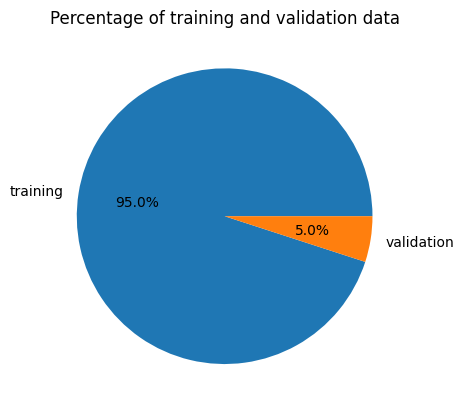

In [24]:
import os
import matplotlib.pyplot as plt
import numpy as np

total_image_training = 0
total_image_validation = 0

# Walk through pizza_steak directory and list number of files
for dirpath, dirnames, filenames in os.walk("/content/food-101/train"):
  total_image_training += len(filenames)

for dirpath, dirnames, filenames in os.walk("/content/food-101/validation"):
  total_image_validation += len(filenames)

print(f"Total training images: {total_image_training}")
print(f"Total validation images: {total_image_validation}")

print(f"Percentage of training data: {total_image_training/(total_image_training + total_image_validation)*100}%")
print(f"Percentage of validation data: {total_image_validation/(total_image_training + total_image_validation)*100}%")

plot_data = np.array([total_image_training, total_image_validation])

plot_labels = ["training", "validation"]

plt.pie(plot_data, labels=plot_labels, autopct='%1.1f%%')
plt.title('Percentage of training and validation data')


### View an image

In [25]:
# View an image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import random

def view_random_image(target_dir, target_class):
  # Setup target directory (we'll view images from here)
  target_folder = target_dir+target_class

  # Get a random image path
  random_image = random.sample(os.listdir(target_folder), 1)

  # Read in the image and plot it using matplotlib
  img = mpimg.imread(target_folder + "/" + random_image[0])
  plt.imshow(img)
  plt.title(target_class)
  plt.axis("off");

  print(f"Image shape: {img.shape}") # show the shape of the image

  return img

Image shape: (512, 382, 3)


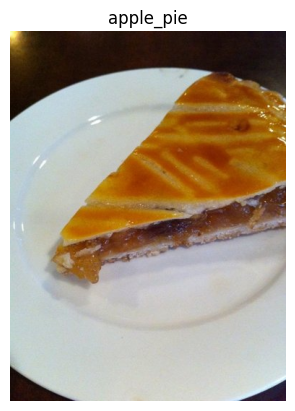

In [26]:
img = view_random_image(target_dir="/content/food-101/train/", target_class= str(class_names[0]))

array([[[247, 255, 189],
        [242, 252, 179],
        [241, 248, 168],
        ...,
        [ 25,  20,  27],
        [ 24,  21,  28],
        [ 25,  22,  29]],

       [[251, 255, 191],
        [248, 255, 183],
        [245, 252, 172],
        ...,
        [ 26,  21,  28],
        [ 23,  20,  27],
        [ 23,  20,  27]],

       [[254, 255, 193],
        [253, 255, 185],
        [251, 254, 175],
        ...,
        [ 26,  21,  28],
        [ 23,  20,  27],
        [ 22,  19,  26]],

       ...,

       [[ 23,   9,   8],
        [ 24,  10,   9],
        [ 27,  11,  11],
        ...,
        [ 52,  26,  51],
        [ 51,  25,  50],
        [ 53,  27,  52]],

       [[ 19,   8,   6],
        [ 19,   8,   6],
        [ 23,   9,   8],
        ...,
        [ 53,  25,  50],
        [ 50,  22,  47],
        [ 51,  23,  48]],

       [[ 24,  13,  11],
        [ 22,  11,   9],
        [ 23,   9,   8],
        ...,
        [ 53,  25,  50],
        [ 52,  24,  49],
        [ 54,  26,  51]]], dtype=uint8)
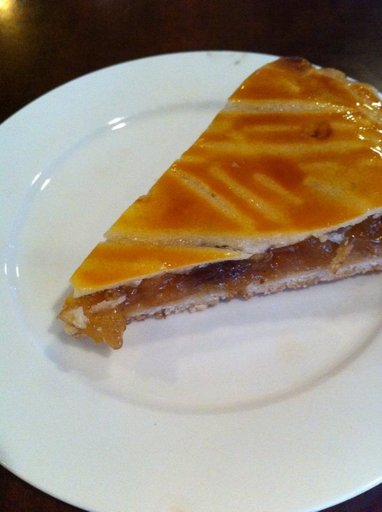

In [27]:
img[:][:][:]

In [28]:
# Divide all pixel values with 255
img[:][:][:]/255

array([[[0.96862745, 1.        , 0.74117647],
        [0.94901961, 0.98823529, 0.70196078],
        [0.94509804, 0.97254902, 0.65882353],
        ...,
        [0.09803922, 0.07843137, 0.10588235],
        [0.09411765, 0.08235294, 0.10980392],
        [0.09803922, 0.08627451, 0.11372549]],

       [[0.98431373, 1.        , 0.74901961],
        [0.97254902, 1.        , 0.71764706],
        [0.96078431, 0.98823529, 0.6745098 ],
        ...,
        [0.10196078, 0.08235294, 0.10980392],
        [0.09019608, 0.07843137, 0.10588235],
        [0.09019608, 0.07843137, 0.10588235]],

       [[0.99607843, 1.        , 0.75686275],
        [0.99215686, 1.        , 0.7254902 ],
        [0.98431373, 0.99607843, 0.68627451],
        ...,
        [0.10196078, 0.08235294, 0.10980392],
        [0.09019608, 0.07843137, 0.10588235],
        [0.08627451, 0.0745098 , 0.10196078]],

       ...,

       [[0.09019608, 0.03529412, 0.03137255],
        [0.09411765, 0.03921569, 0.03529412],
        [0.10588235, 0

## View random images by classes

In [36]:
# View a random image from the training dataset
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def view_a_random_image(target_dir, target_class):
  print(f"Image class: {target_class}")
  plt.figure(figsize=(5, 5))  # Adjust figure size as need
  target_folder = target_dir + target_class
  random_image = random.sample(os.listdir(target_folder), 2)

  plt.subplot(1, 2, 1)
  img = mpimg.imread(target_folder + "/" + random_image[0])
  plt.imshow(img)
  plt.axis("off")

  plt.subplot(1, 2, 2)
  img = mpimg.imread(target_folder + "/" + random_image[1])
  plt.imshow(img)
  plt.axis("off")
  plt.show()




Image class: apple_pie


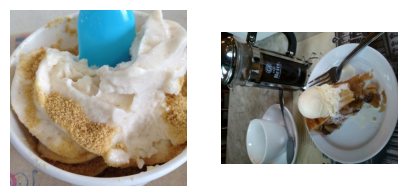

Image class: baby_back_ribs


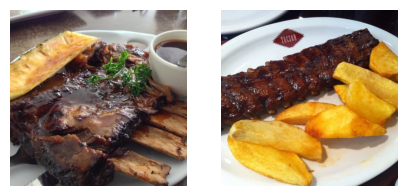

Image class: baklava


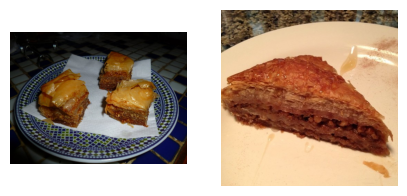

Image class: beef_carpaccio


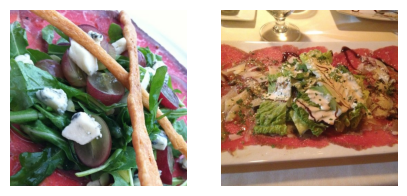

Image class: beef_tartare


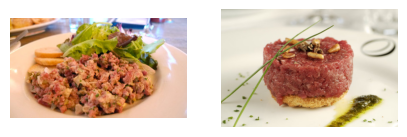

Image class: beet_salad


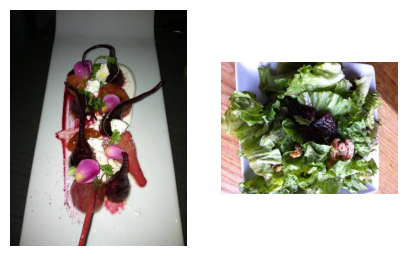

Image class: beignets


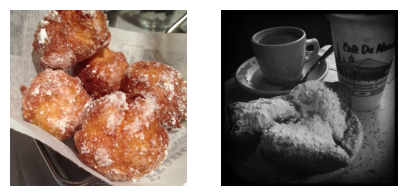

Image class: bibimbap


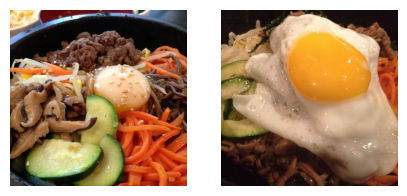

Image class: bread_pudding


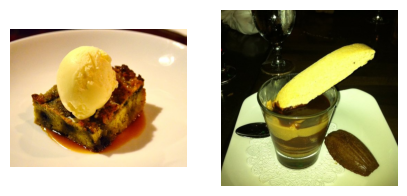

Image class: breakfast_burrito


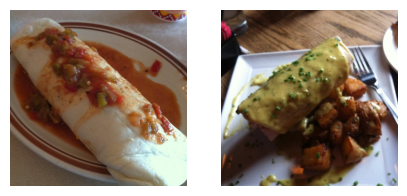

Image class: bruschetta


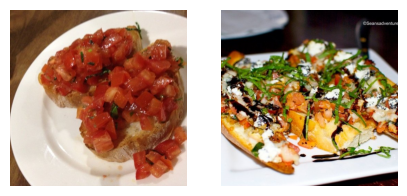

Image class: caesar_salad


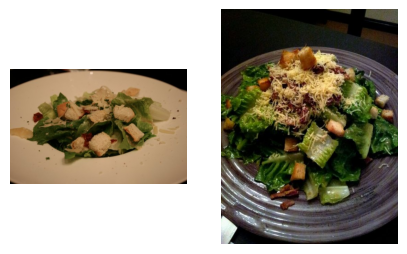

Image class: cannoli


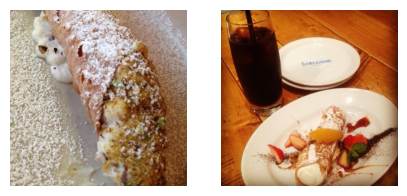

Image class: caprese_salad


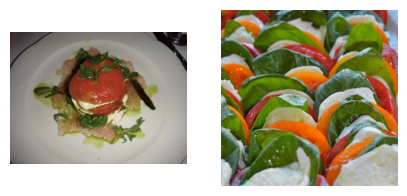

Image class: carrot_cake


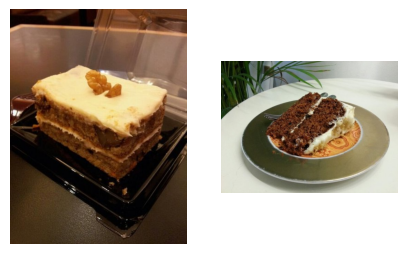

Image class: ceviche


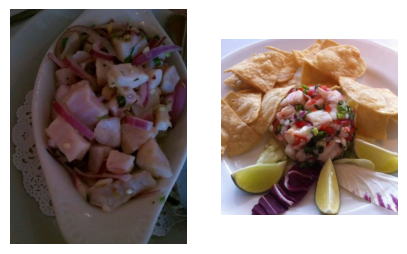

Image class: cheese_plate


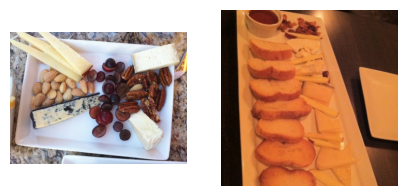

Image class: cheesecake


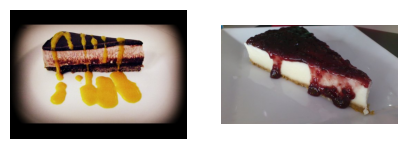

Image class: chicken_curry


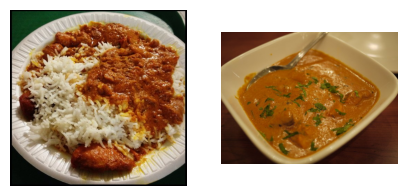

Image class: chicken_quesadilla


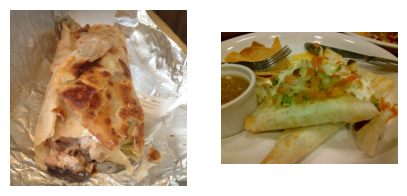

Image class: chicken_wings


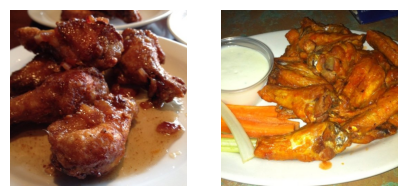

Image class: chocolate_cake


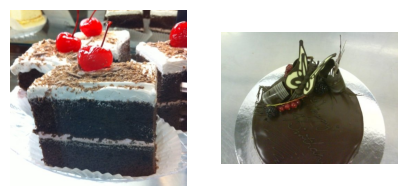

Image class: chocolate_mousse


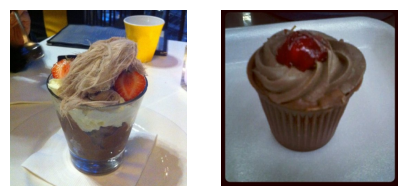

Image class: churros


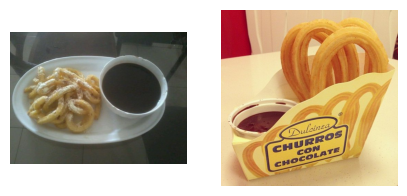

Image class: clam_chowder


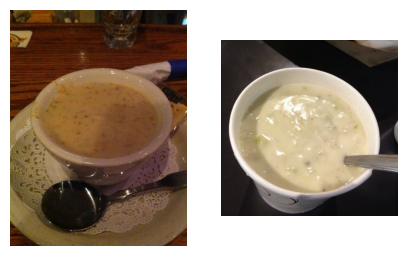

Image class: club_sandwich


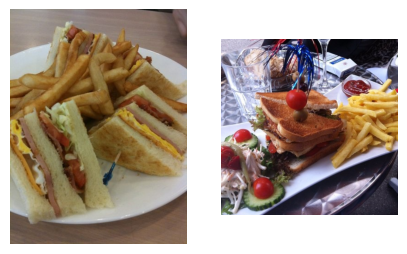

Image class: crab_cakes


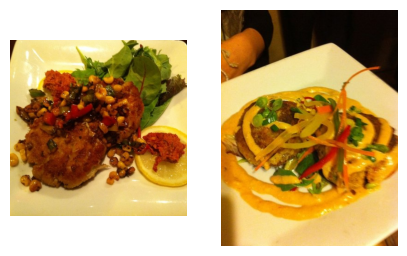

Image class: creme_brulee


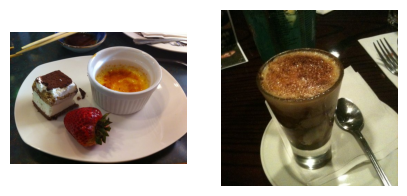

Image class: croque_madame


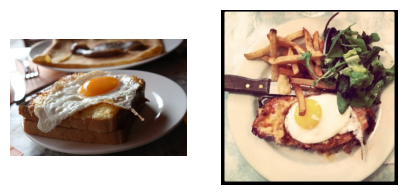

Image class: cup_cakes


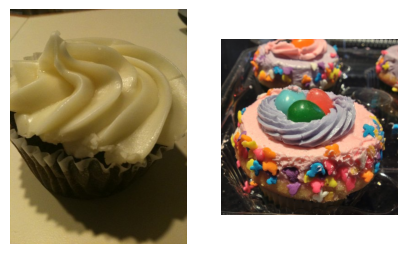

Image class: deviled_eggs


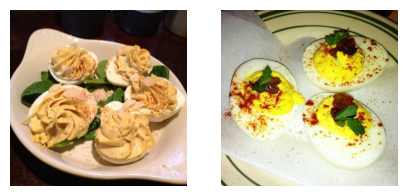

Image class: donuts


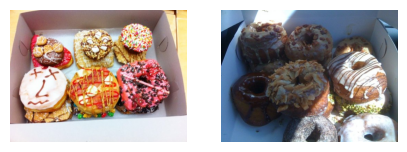

Image class: dumplings


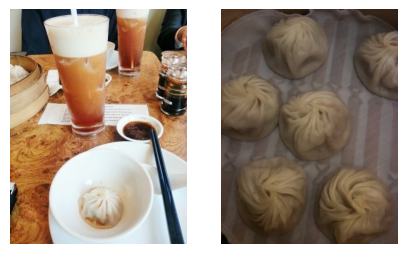

Image class: edamame


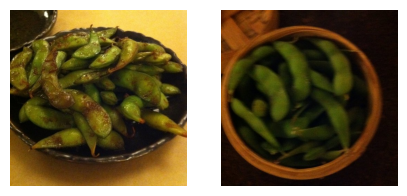

Image class: eggs_benedict


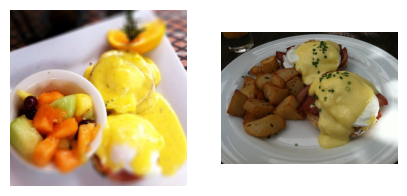

Image class: escargots


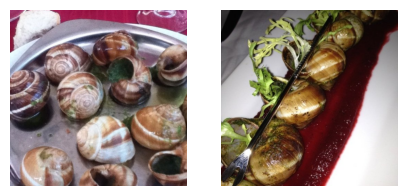

Image class: falafel


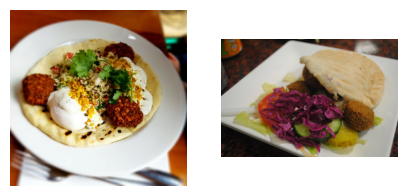

Image class: filet_mignon


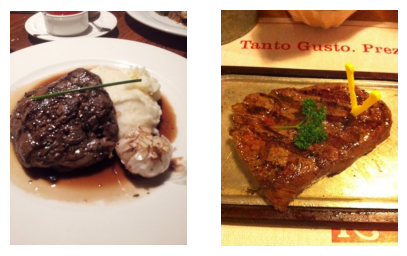

Image class: fish_and_chips


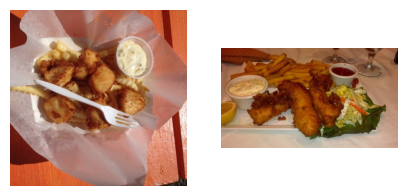

Image class: foie_gras


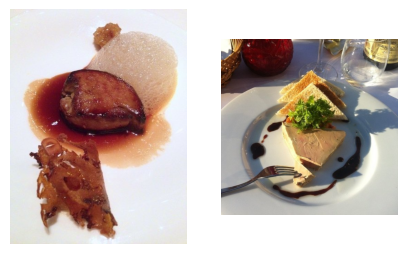

Image class: french_fries


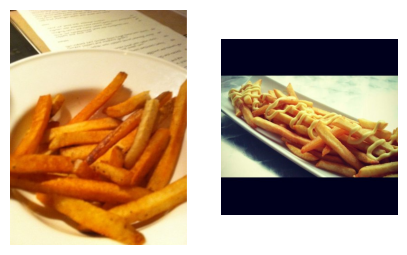

Image class: french_onion_soup


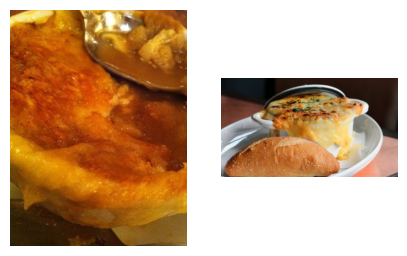

Image class: french_toast


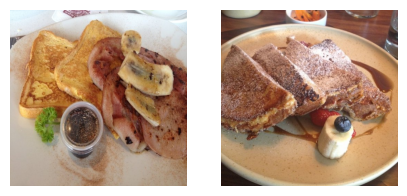

Image class: fried_calamari


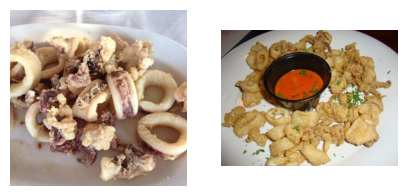

Image class: fried_rice


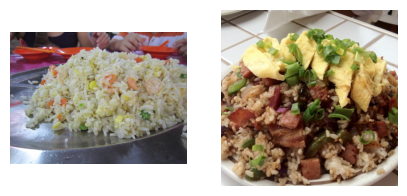

Image class: frozen_yogurt


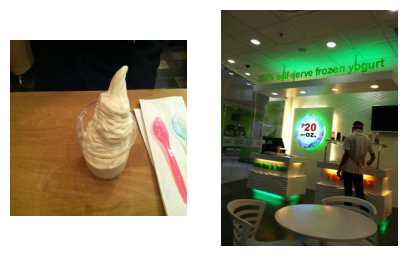

Image class: garlic_bread


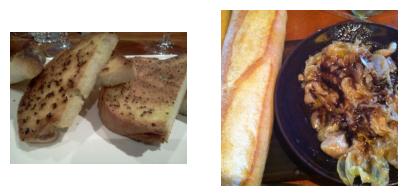

Image class: gnocchi


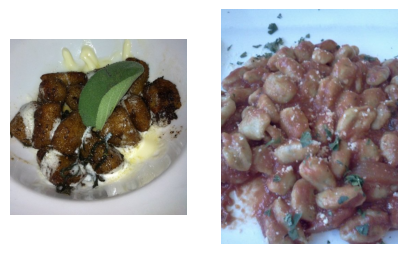

Image class: greek_salad


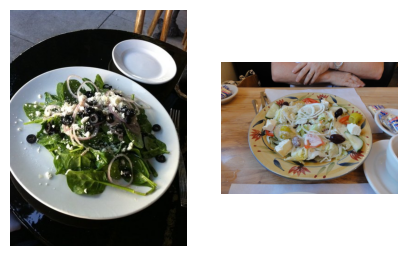

Image class: grilled_cheese_sandwich


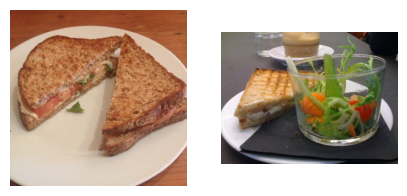

Image class: grilled_salmon


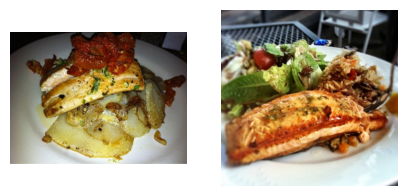

Image class: guacamole


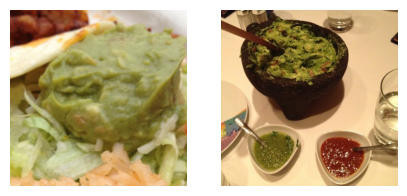

Image class: gyoza


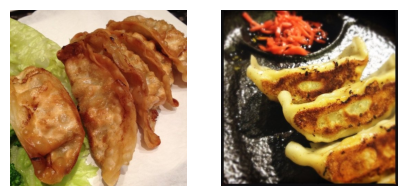

Image class: hamburger


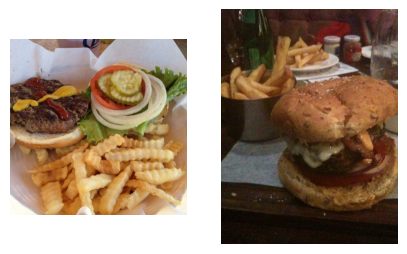

Image class: hot_and_sour_soup


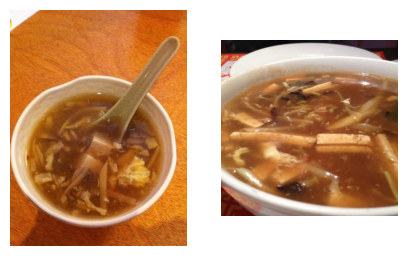

Image class: hot_dog


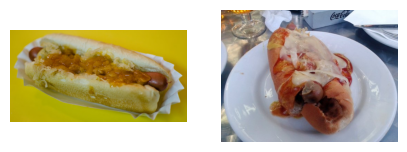

Image class: huevos_rancheros


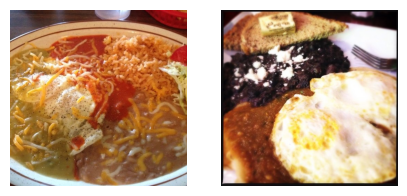

Image class: hummus


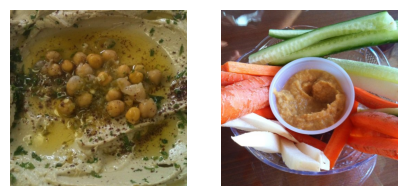

Image class: ice_cream


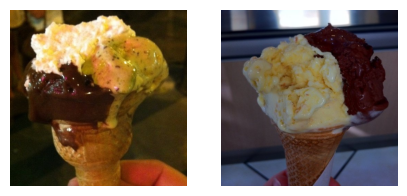

Image class: lasagna


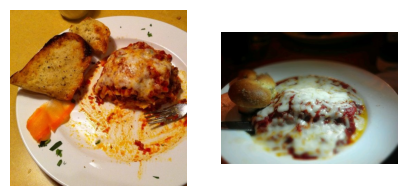

Image class: lobster_bisque


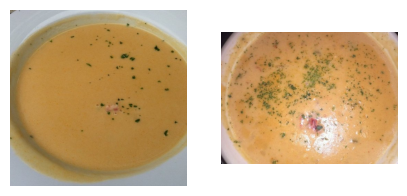

Image class: lobster_roll_sandwich


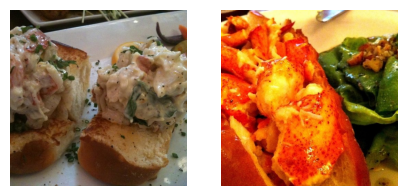

Image class: macaroni_and_cheese


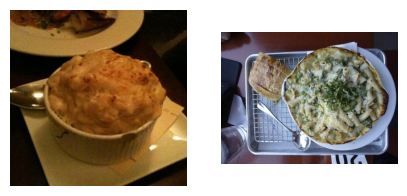

Image class: macarons


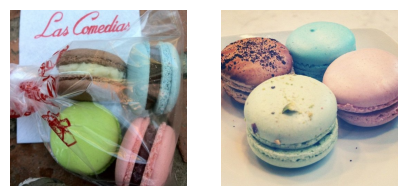

Image class: miso_soup


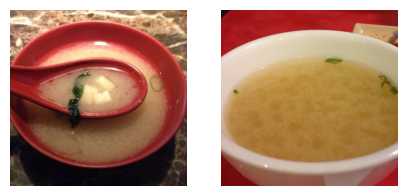

Image class: mussels


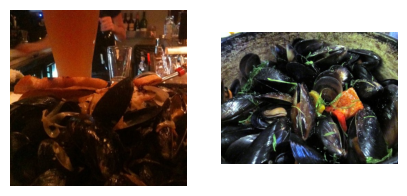

Image class: nachos


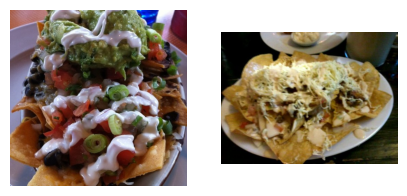

Image class: omelette


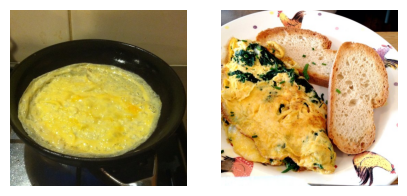

Image class: onion_rings


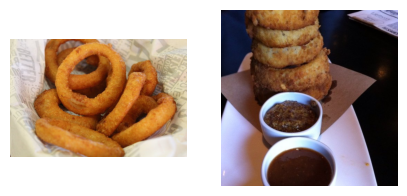

Image class: oysters


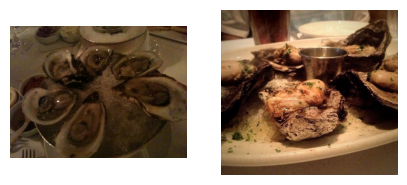

Image class: pad_thai


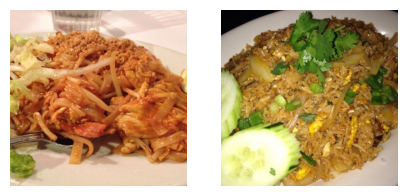

Image class: paella


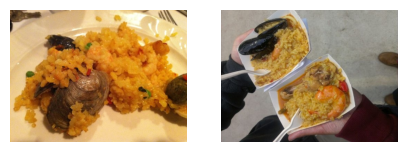

Image class: pancakes


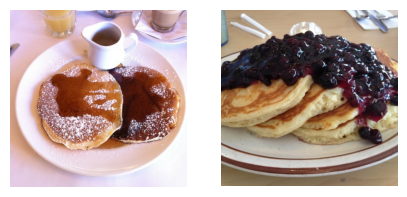

Image class: panna_cotta


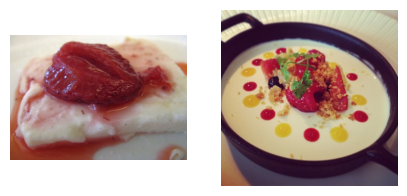

Image class: peking_duck


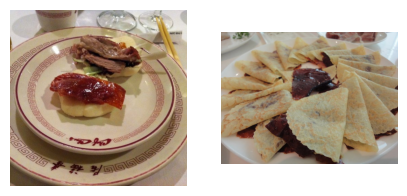

Image class: pho


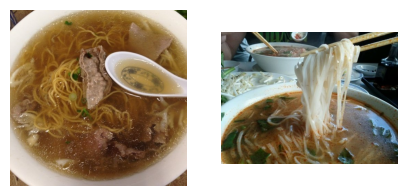

Image class: pizza


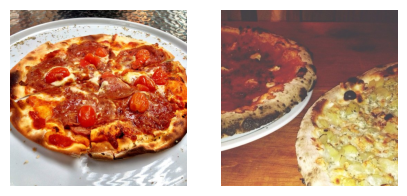

Image class: pork_chop


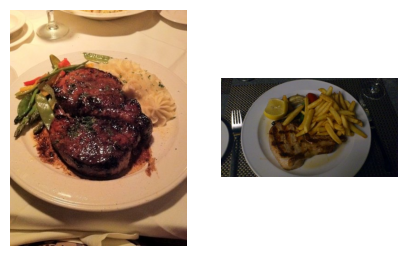

Image class: poutine


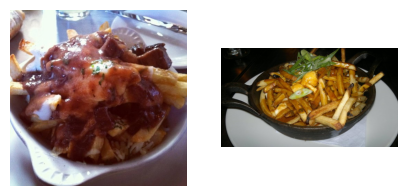

Image class: prime_rib


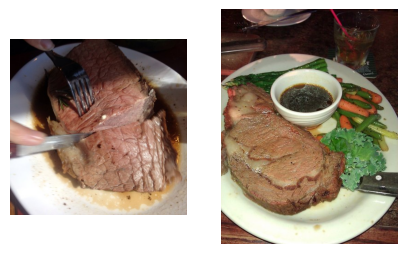

Image class: pulled_pork_sandwich


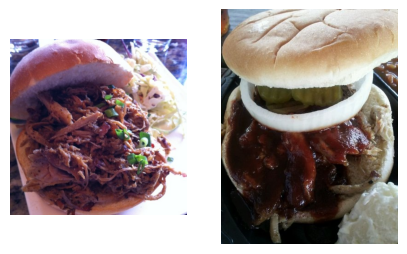

Image class: ramen


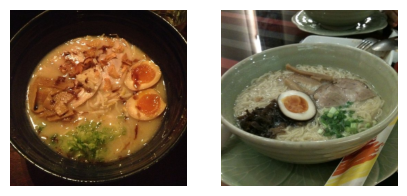

Image class: ravioli


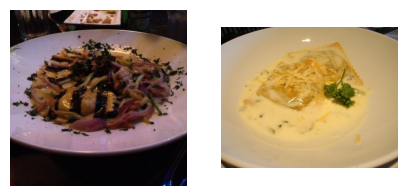

Image class: red_velvet_cake


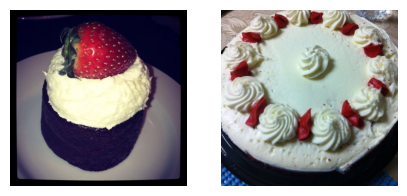

Image class: risotto


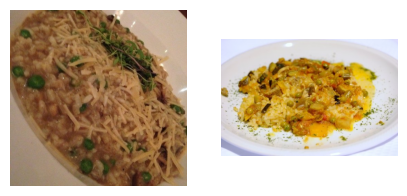

Image class: samosa


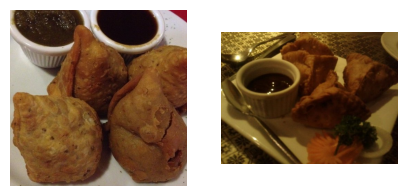

Image class: sashimi


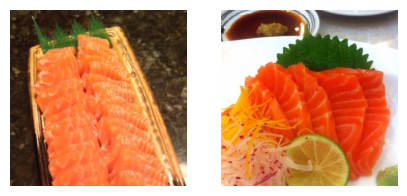

Image class: scallops


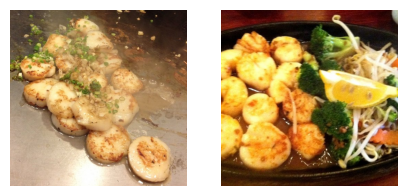

Image class: seaweed_salad


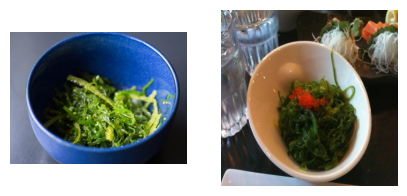

Image class: shrimp_and_grits


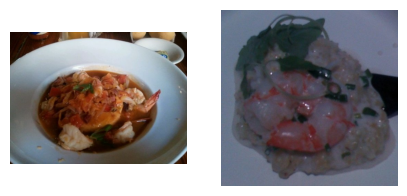

Image class: spaghetti_bolognese


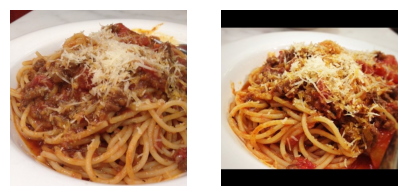

Image class: spaghetti_carbonara


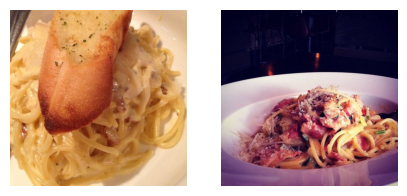

Image class: spring_rolls


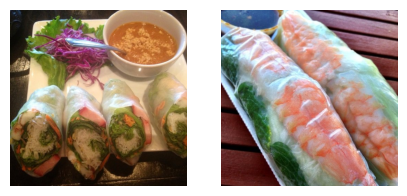

Image class: steak


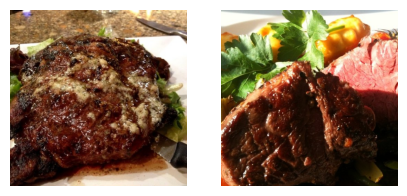

Image class: strawberry_shortcake


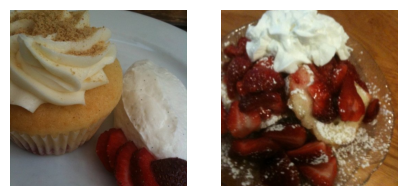

Image class: sushi


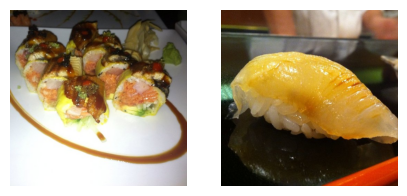

Image class: tacos


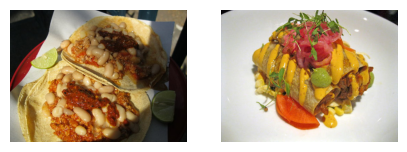

Image class: takoyaki


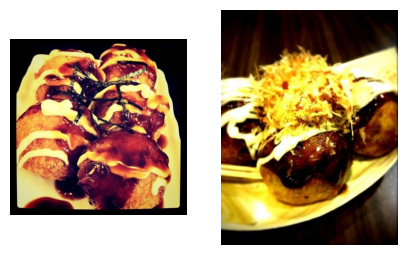

Image class: tiramisu


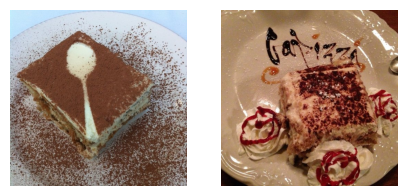

Image class: tuna_tartare


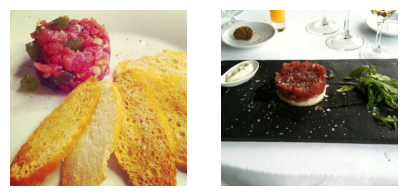

Image class: waffles


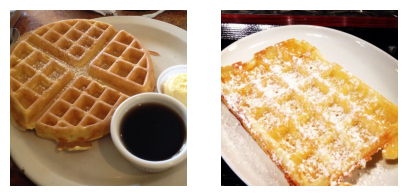

In [37]:
for class_name in class_names:
  view_a_random_image(target_dir="/content/food-101/train/", target_class= str(class_name))

# Create training data for model


In [46]:
import tensorflow as tf

# Create a dataset from the directory
batch_size = 32
img_height = 224
img_width = 224

# Load the dataset
X_train_model_1 = tf.keras.preprocessing.image_dataset_from_directory(
    '/content/food-101/train',
    image_size=(img_height, img_width),  # Resize all images to this size
    batch_size=batch_size,
    label_mode='categorical',  #'categorical' for one-hot encoding
    shuffle =True,  # Shuffle the dataset
    seed = 42  # Set a seed for reproducibility
)

y_validation_model_1 = tf.keras.preprocessing.image_dataset_from_directory(
    '/content/food-101/validation',
    image_size=(img_height, img_width),  # Resize all images to this size
    batch_size=batch_size,
    label_mode='categorical',  #'categorical' for one-hot encoding
    shuffle =True,  # Shuffle the dataset
    seed = 42  # Set a seed for reproducibility
)


# Verify the dataset
training_class_names = X_train_model_1.class_names
print("Training classnames: " ,class_names)

validation_class_names = y_validation_model_1.class_names
print("Validation classnames: " ,class_names)


Found 95950 files belonging to 101 classes.
Found 5050 files belonging to 101 classes.
Training classnames:  ['apple_pie' 'baby_back_ribs' 'baklava' 'beef_carpaccio' 'beef_tartare'
 'beet_salad' 'beignets' 'bibimbap' 'bread_pudding' 'breakfast_burrito'
 'bruschetta' 'caesar_salad' 'cannoli' 'caprese_salad' 'carrot_cake'
 'ceviche' 'cheese_plate' 'cheesecake' 'chicken_curry'
 'chicken_quesadilla' 'chicken_wings' 'chocolate_cake' 'chocolate_mousse'
 'churros' 'clam_chowder' 'club_sandwich' 'crab_cakes' 'creme_brulee'
 'croque_madame' 'cup_cakes' 'deviled_eggs' 'donuts' 'dumplings' 'edamame'
 'eggs_benedict' 'escargots' 'falafel' 'filet_mignon' 'fish_and_chips'
 'foie_gras' 'french_fries' 'french_onion_soup' 'french_toast'
 'fried_calamari' 'fried_rice' 'frozen_yogurt' 'garlic_bread' 'gnocchi'
 'greek_salad' 'grilled_cheese_sandwich' 'grilled_salmon' 'guacamole'
 'gyoza' 'hamburger' 'hot_and_sour_soup' 'hot_dog' 'huevos_rancheros'
 'hummus' 'ice_cream' 'lasagna' 'lobster_bisque' 'lobster_

In [44]:
print(X_train_model_1)
print(X_train_model_1)


<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 101), dtype=tf.float32, name=None))>
<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 101), dtype=tf.float32, name=None))>


### Normalize the images

In [50]:
# Normalize the images
def normalize_img(image, label):
    return tf.cast(image, tf.float32) / 255.0, label


# Using Neuron Network model to train model for image classifiction problem

- Neuron Network is a powerful tool to deal with many problem even classification problem. However, NN model will struggle to deal with the image data that we are having

In [54]:
training_data_model_v1 = X_train_model_1.map(normalize_img)
validation_data_model_v1 = y_validation_model_1.map(normalize_img)

training_data_model_v1,validation_data_model_v1

(<_MapDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 101), dtype=tf.float32, name=None))>,
 <_MapDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 101), dtype=tf.float32, name=None))>)

In [68]:
# Fetch one batch of data
for images, labels in training_data_model_v1.take(1):
    print("Images shape:", images.shape)
    print("Labels shape:", labels.shape)
    print("First image (normalized):", images[0])  # This prints pixel values
    print("First label (one-hot):", labels[0])

Images shape: (32, 224, 224, 3)
Labels shape: (32, 101)
First image (normalized): tf.Tensor(
[[[0.3304722  0.26380554 0.30302122]
  [0.3101641  0.2434974  0.28271312]
  [0.31730694 0.25456184 0.29377753]
  ...
  [0.4767506  0.48851532 0.55686253]
  [0.4694678  0.4812325  0.5478991 ]
  [0.4694678  0.4812325  0.5478991 ]]

 [[0.35362145 0.29479793 0.3222489 ]
  [0.33693478 0.27811125 0.30556223]
  [0.36352542 0.3047019  0.33215287]
  ...
  [0.46386546 0.47563016 0.55013996]
  [0.45518202 0.46694672 0.5414565 ]
  [0.4515406  0.46096453 0.54015595]]

 [[0.31600642 0.2745498  0.2972389 ]
  [0.2807923  0.23149258 0.25810322]
  [0.35012007 0.29913968 0.32593036]
  ...
  [0.44687867 0.44827923 0.53147256]
  [0.44313726 0.4414566  0.5338935 ]
  [0.4434374  0.44175673 0.53587437]]

 ...

 [[0.19691893 0.10924361 0.07703081]
  [0.1957984  0.09943969 0.07114846]
  [0.20176083 0.0965386  0.07106847]
  ...
  [0.16862746 0.13725491 0.12941177]
  [0.1677872  0.13641465 0.12857151]
  [0.17170876 0.1403

In [ ]:
import tensorflow as tf

train_data = training_data_model_v1.repeat(10)
valid_data = validation_data_model_v1.repeat(10)

# Create a model to replicate the TensorFlow Playground model
model_1 = tf.keras.Sequential([
  tf.keras.layers.Input(shape=(224, 224, 3)),
  tf.keras.layers.Flatten(), # dense layers expect a 1-dimensional vector as input
  tf.keras.layers.Dense(4, activation='relu'),
  tf.keras.layers.Dense(4, activation='relu'),
  tf.keras.layers.Dense(101, activation='softmax')
])

# Compile the model
model_1.compile(loss='categorical_crossentropy',
              optimizer=tf.keras.optimizers.Adam(),
              metrics=["accuracy", "recall", "precision"])

# Fit the model
history_1 = model_1.fit(train_data,
                        epochs=10,
                        steps_per_epoch=len(train_data)//10,
                        validation_data=valid_data,
                        validation_steps=len(valid_data)//10)